# DA5401- Assignment 8
##  Preethi MM21B051

This code implements the AdaBoost algorithm from scratch using decision stumps (shallow DecisionTreeClassifier) as weak classifiers. AdaBoost iteratively trains these classifiers, adjusts sample weights based on their misclassifications, and combines them into a strong classifier by weighting their contributions.

Key functions:
- fit: Trains weak classifiers, calculates their importance (alpha), updates sample weights, and plots decision boundaries at each iteration.
- predict: Aggregates predictions from all weak classifiers to form the final ensemble prediction.

We `make_circles` dataset and visualizes both the iterative AdaBoost process and the final ensemble decision boundary.

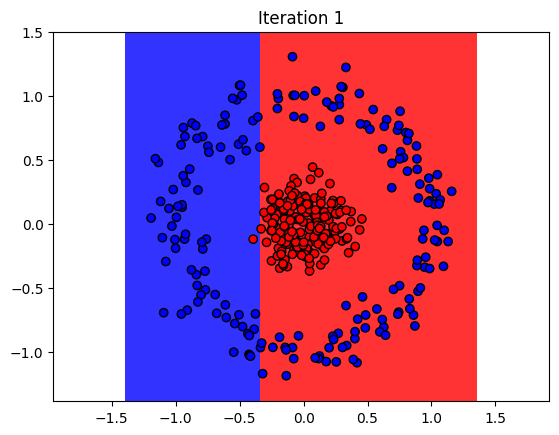

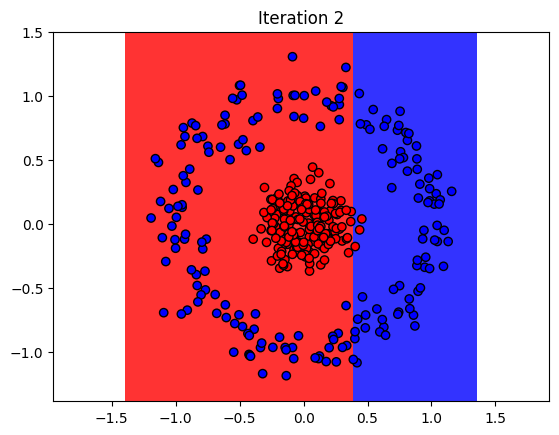

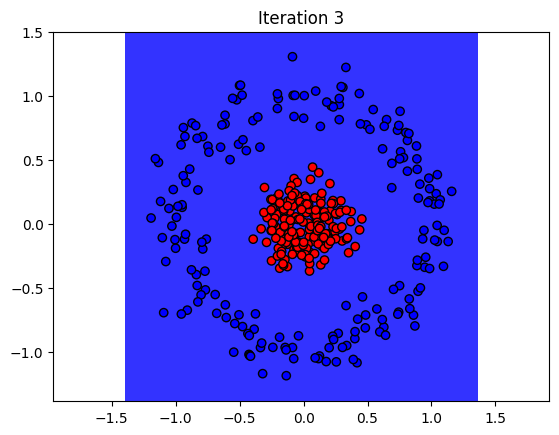

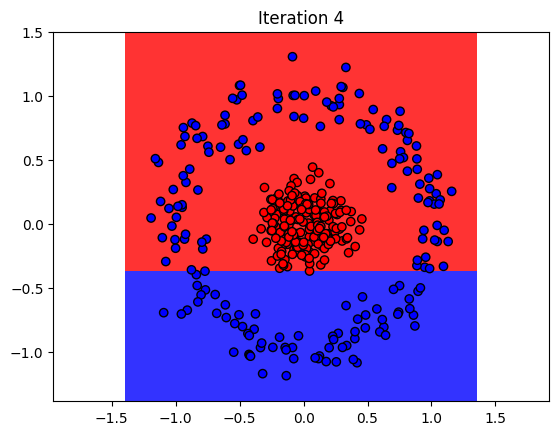

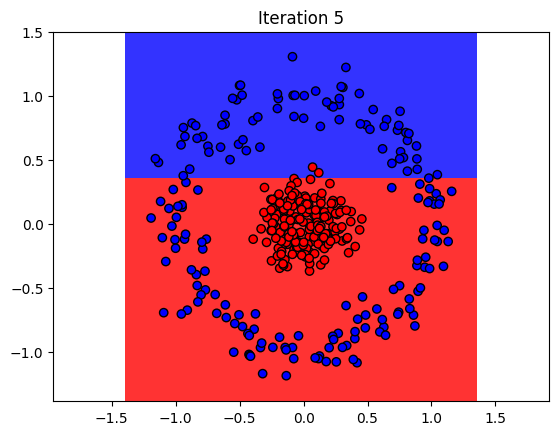

...

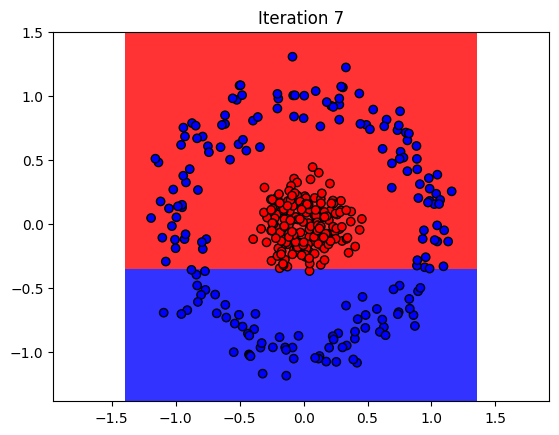

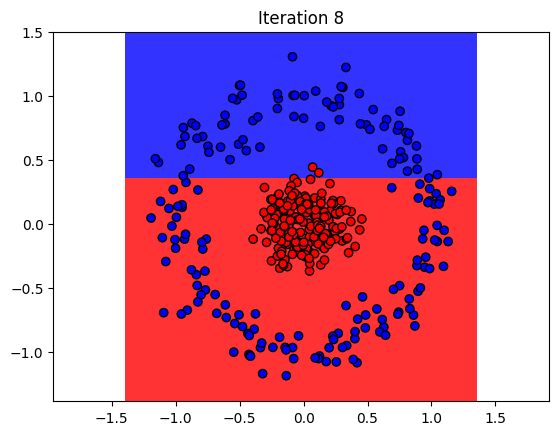

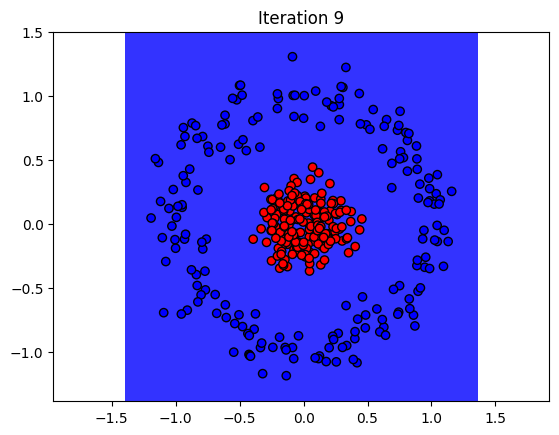

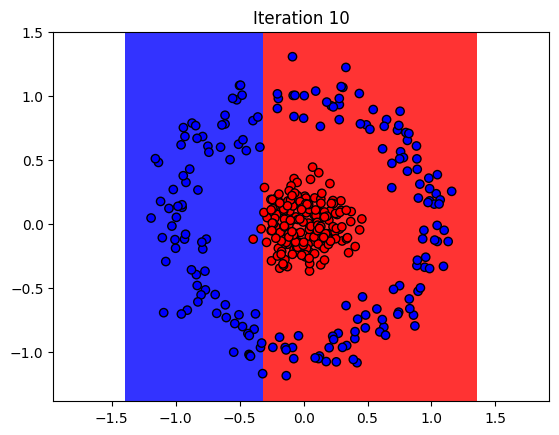

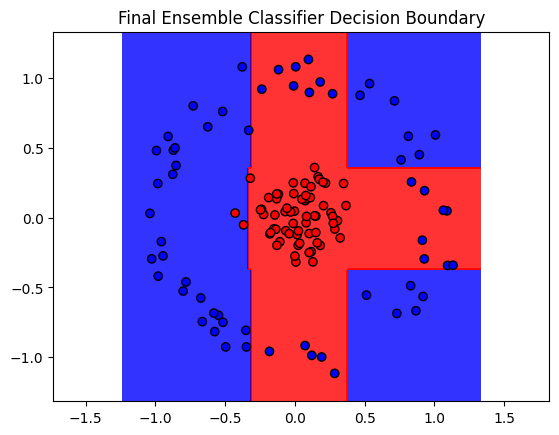

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from sklearn.datasets import make_circles
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

class AdaBoostCustom:
    def __init__(self, n_classifiers=50, eta=0.5):
        self.n_classifiers = n_classifiers
        self.eta = eta
        self.classifiers = []
        self.alphas = []
    
    def fit(self, X, y):
        n_samples = X.shape[0]
        weights = np.ones(n_samples) / n_samples
        
        for i in range(self.n_classifiers):
            clf = DecisionTreeClassifier(max_depth=1)
            clf.fit(X, y, sample_weight=weights)
            predictions = clf.predict(X)
            
            err = np.sum(weights * (predictions != y)) / np.sum(weights)
            alpha = self.eta * np.log((1 - err) / err)
            
            weights *= np.exp(alpha * (predictions != y))
            weights /= np.sum(weights)
            
            self.classifiers.append(clf)
            self.alphas.append(alpha)
            
            self.plot_iteration(X, y, clf, i)
    
    def predict(self, X):
        final_pred = np.zeros(X.shape[0])
        for alpha, clf in zip(self.alphas, self.classifiers):
            final_pred += alpha * clf.predict(X)
        return np.sign(final_pred)
    
    def plot_iteration(self, X, y, clf, iteration):
        x_min, x_max = X[:, 0].min() - 0.2, X[:, 0].max() + 0.2
        y_min, y_max = X[:, 1].min() - 0.2, X[:, 1].max() + 0.2
        xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))
        Z = clf.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)
        
        plt.contourf(xx, yy, Z, alpha=0.8, cmap=colors.ListedColormap(["blue", "red"]))
        plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', cmap=colors.ListedColormap(["blue", "red"]))
        plt.title(f"Iteration {iteration + 1}")
        plt.axis('equal')
        plt.show()

# Generate the dataset
X, y = make_circles(n_samples=500, noise=0.1, random_state=42, factor=0.2)
y = np.where(y == 0, -1, 1)

# Split the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

# Initialize and train the custom AdaBoost classifier
ada = AdaBoostCustom(n_classifiers=10, eta=0.5)
ada.fit(X_train, y_train)

# Plot the final decision boundary
def plot_final_decision_boundary(clf, X, y):
    x_min, x_max = X[:, 0].min() - 0.2, X[:, 0].max() + 0.2
    y_min, y_max = X[:, 1].min() - 0.2, X[:, 1].max() + 0.2
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)

    plt.contourf(xx, yy, Z, alpha=0.8, cmap=colors.ListedColormap(["blue", "red"]))
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', cmap=colors.ListedColormap(["blue", "red"]))
    plt.title("Final Ensemble Classifier Decision Boundary")
    plt.axis('equal')
    plt.show()

plot_final_decision_boundary(ada, X_test, y_test)


We implement AdaBoost from scratch, using various weak classifiers (Logistic Regression, Decision Stump, Decision Tree (depth=3), Linear SVM, and LDA) to classify non-linear data from the 'make_circles' dataset. The algorithm iteratively trains weak classifiers, adjusts sample weights based on classification errors, and combines them into an ensemble. The decision boundaries are visualized at each iteration and after training. Finally, the accuracies of all classifiers are printed for comparison. Hyperparameters are tuned using GridSearch where applicable.

Running AdaBoost with Logistic Regression...


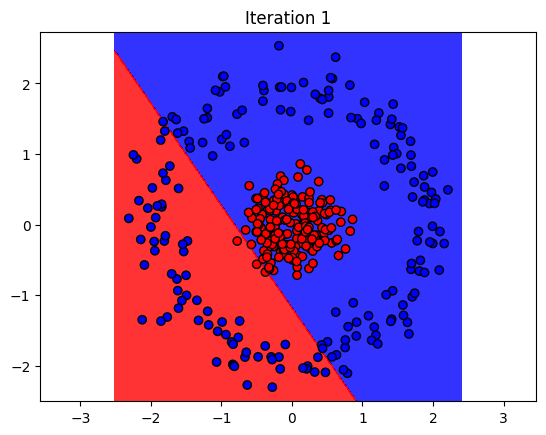

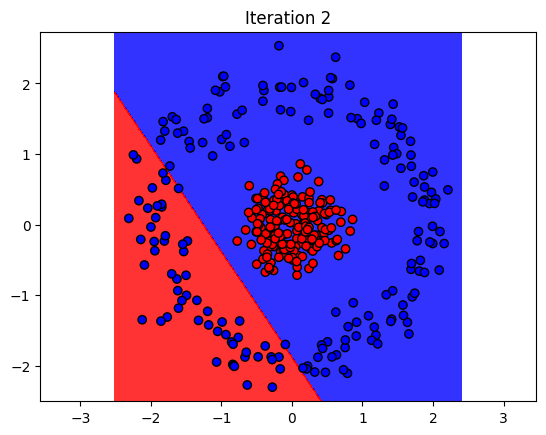

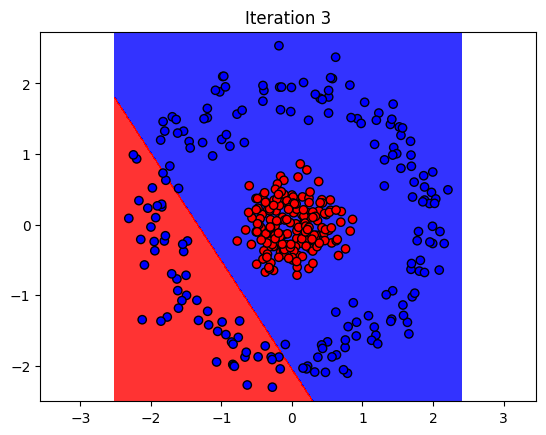

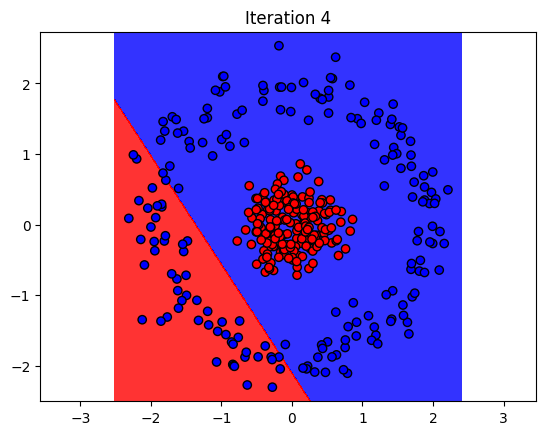

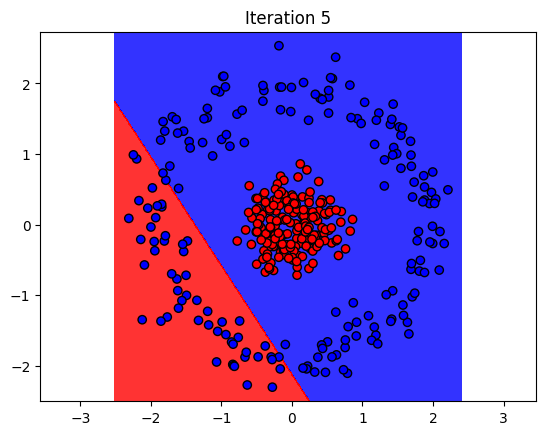

...

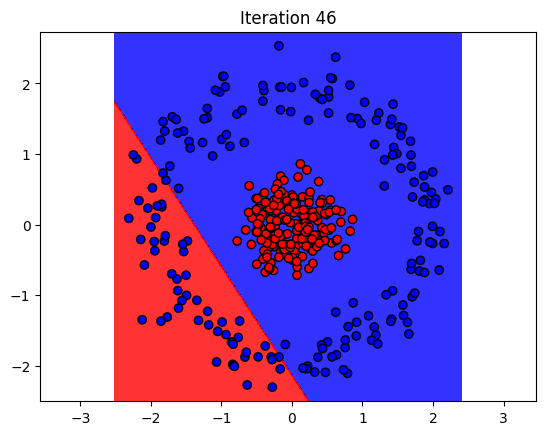

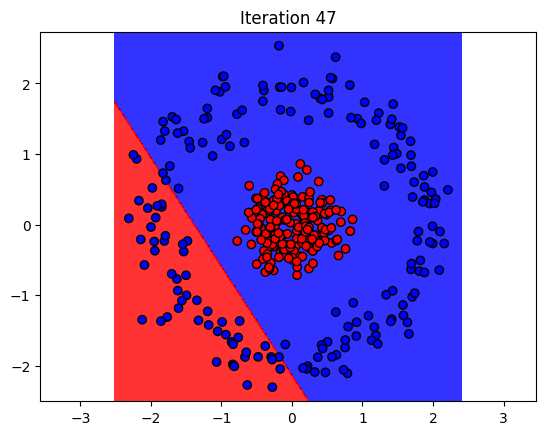

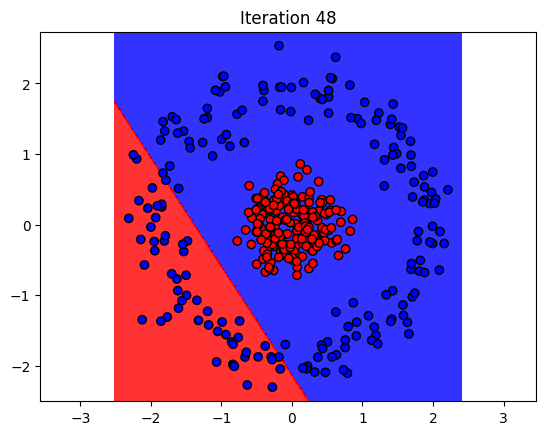

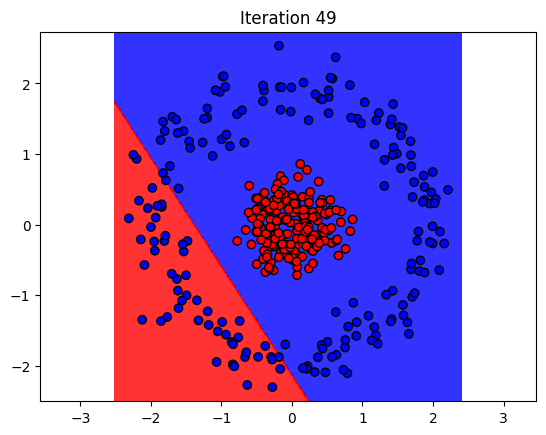

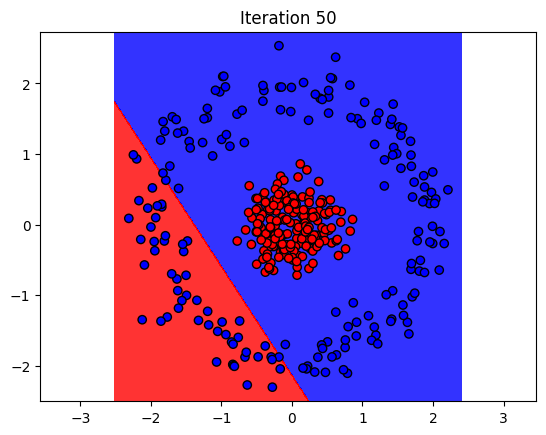

Accuracy with Logistic Regression: 0.7360


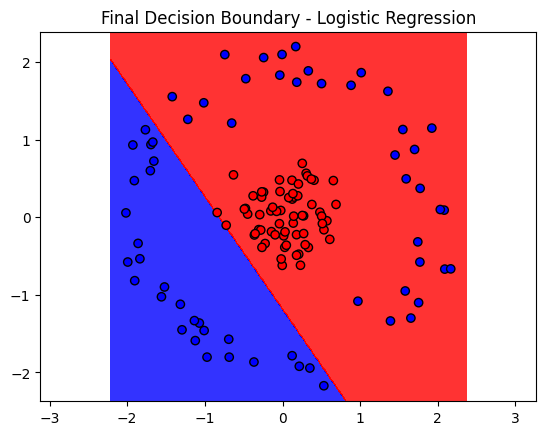

Running AdaBoost with Decision Stump...


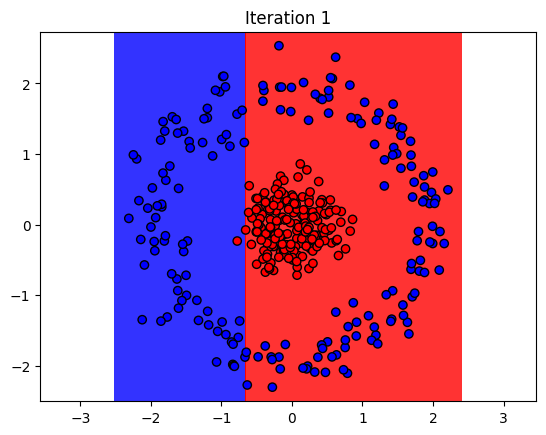

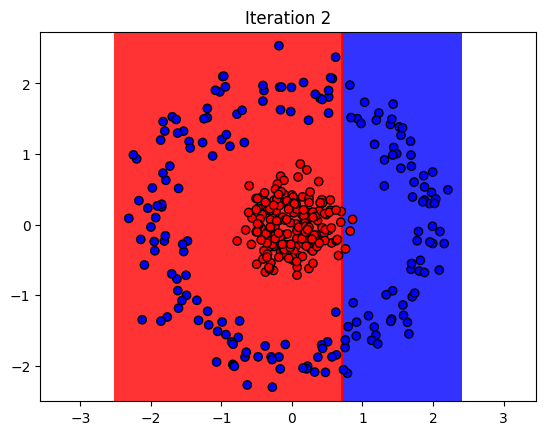

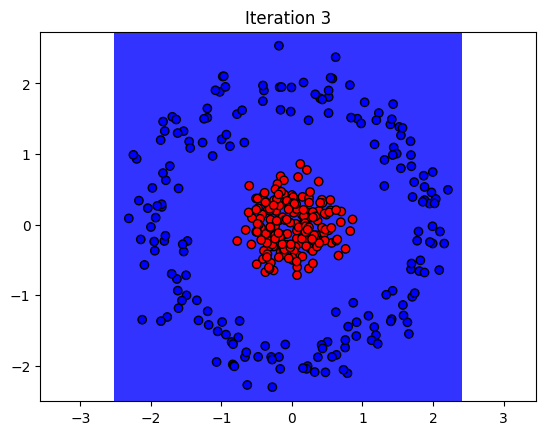

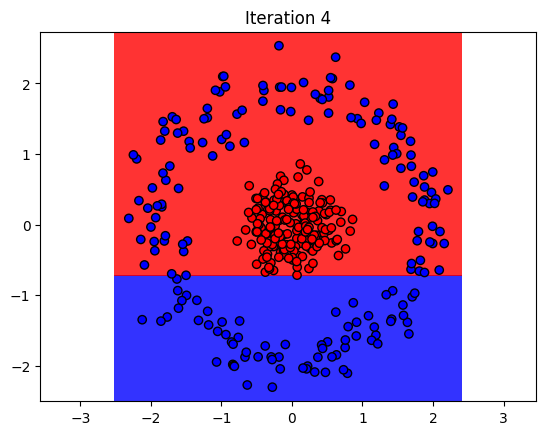

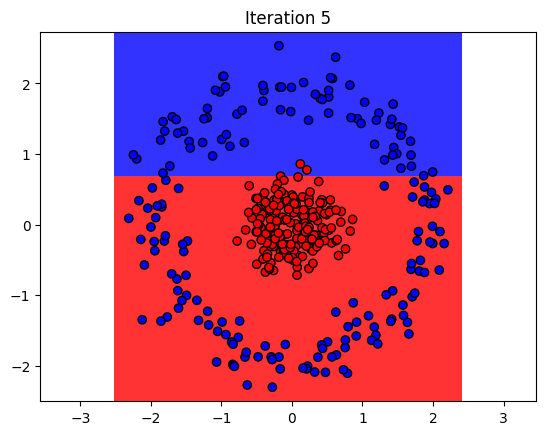

...

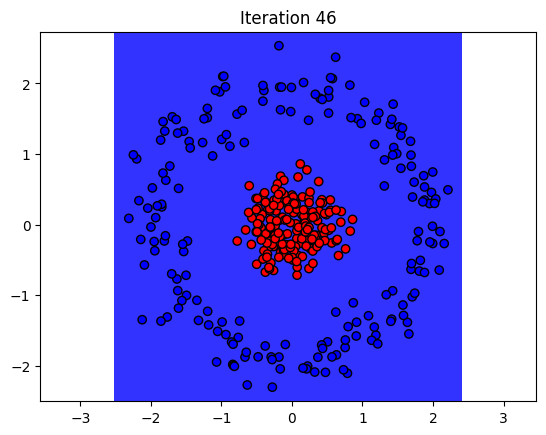

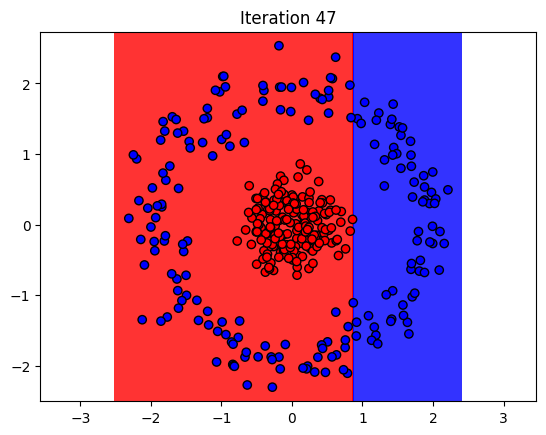

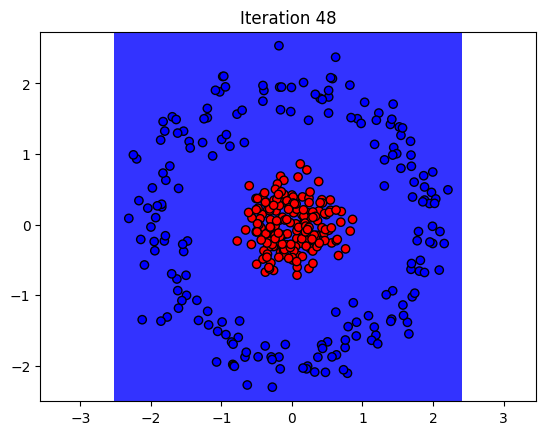

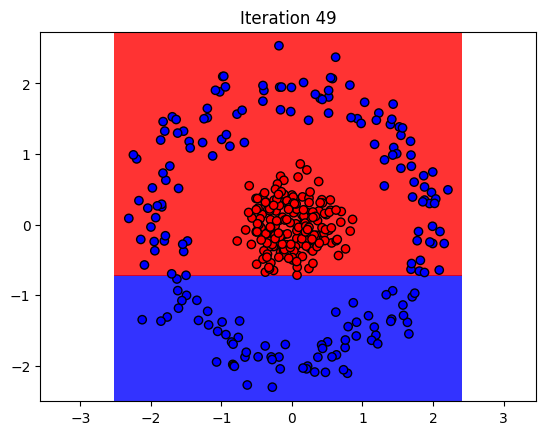

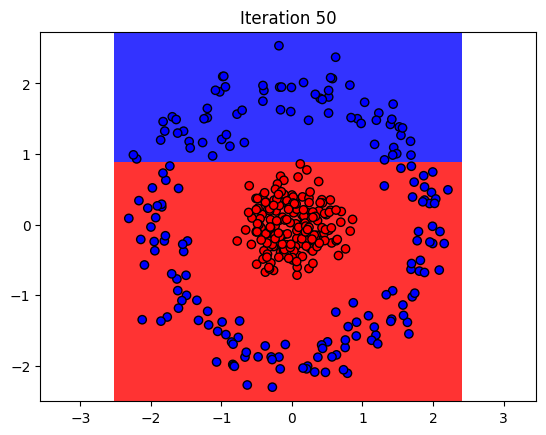

Accuracy with Decision Stump: 0.9920


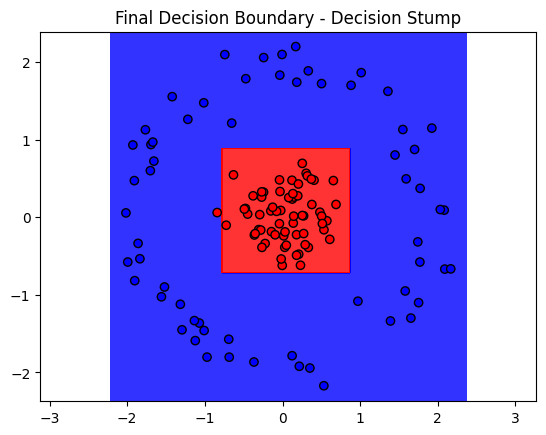

Running AdaBoost with Decision Tree (depth=3)...


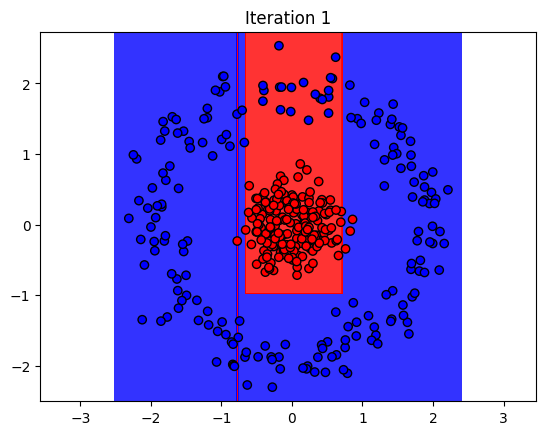

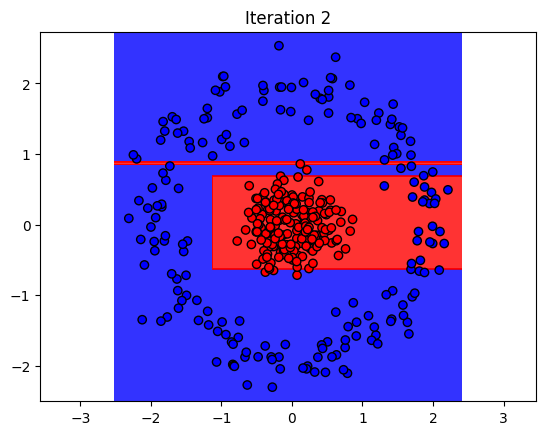

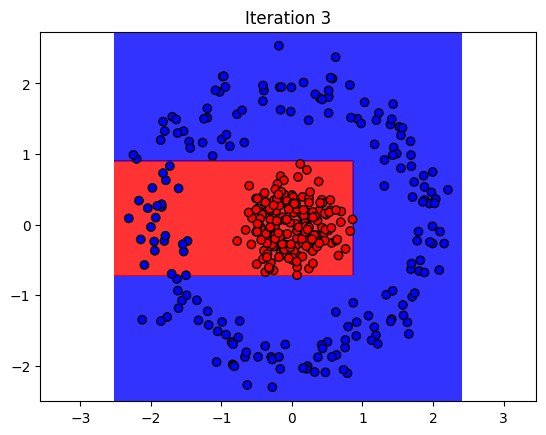

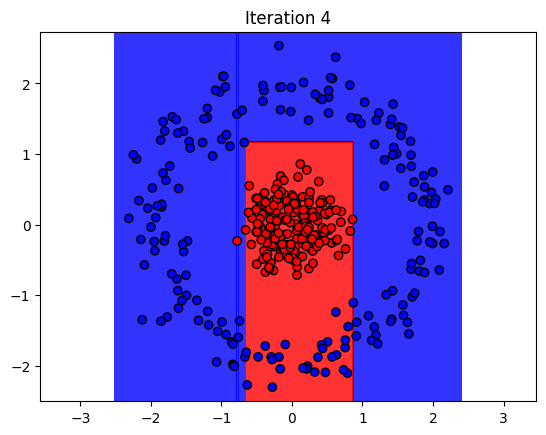

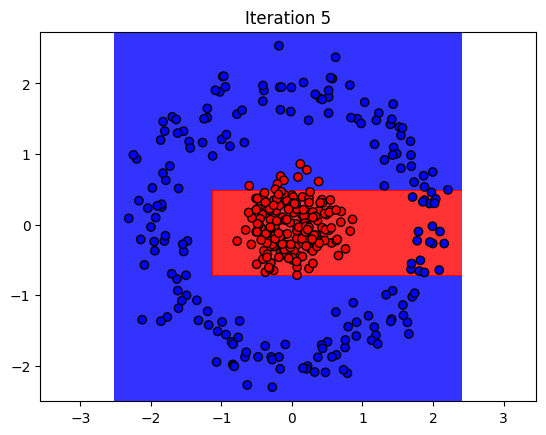

...

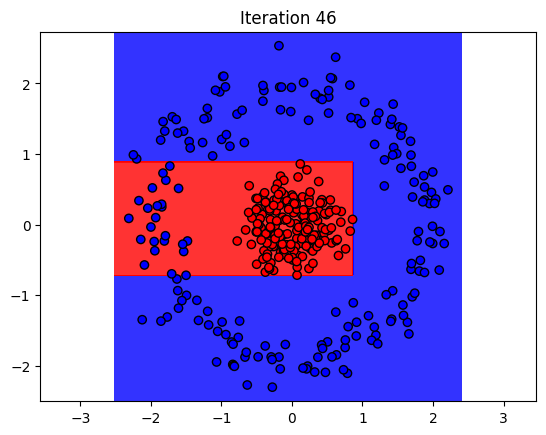

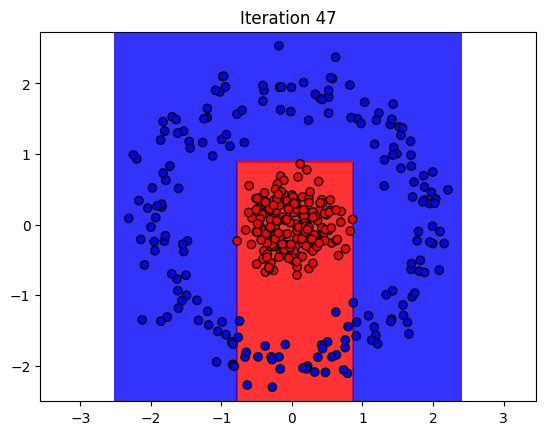

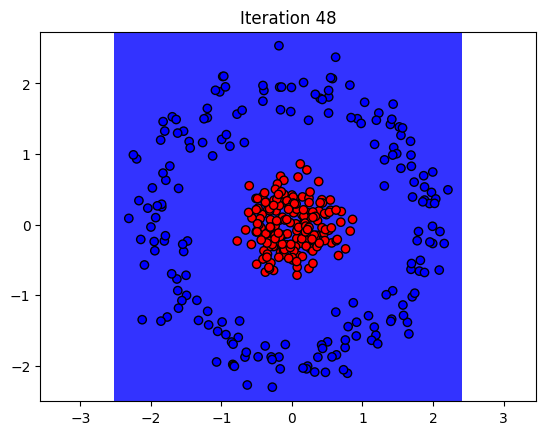

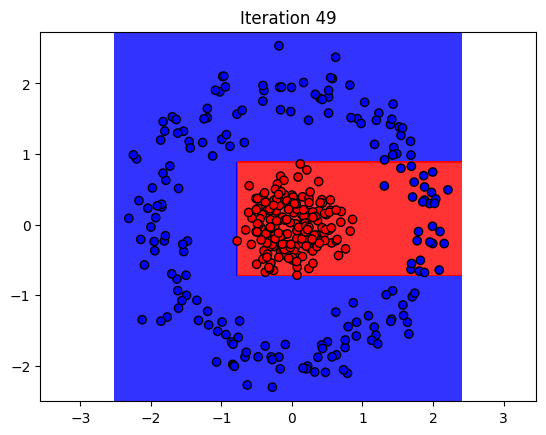

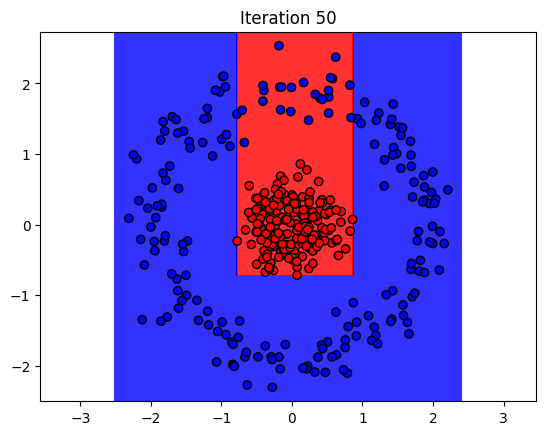

Accuracy with Decision Tree (depth=3): 0.9920


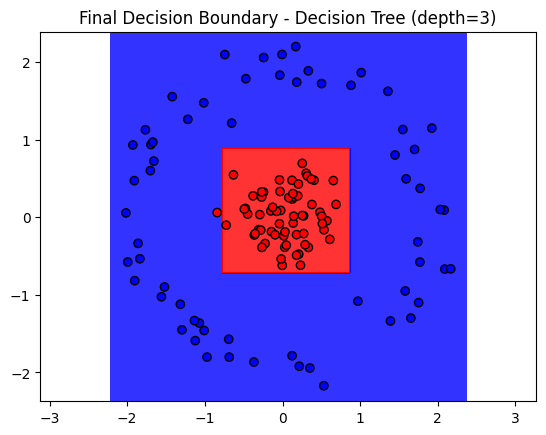

Running AdaBoost with Linear SVM...


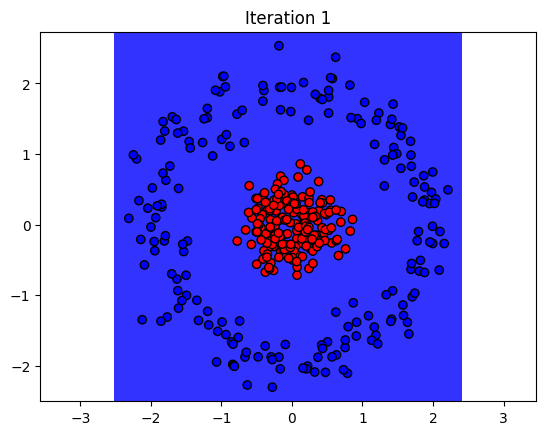

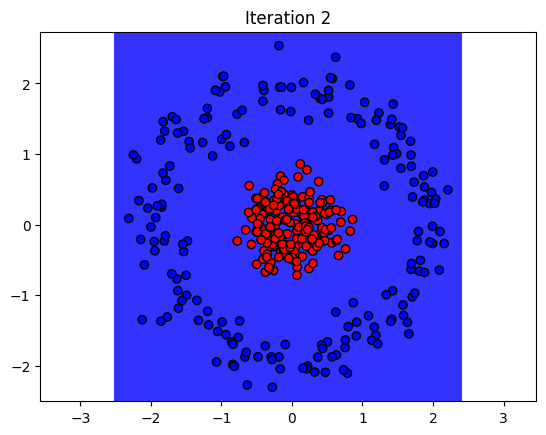

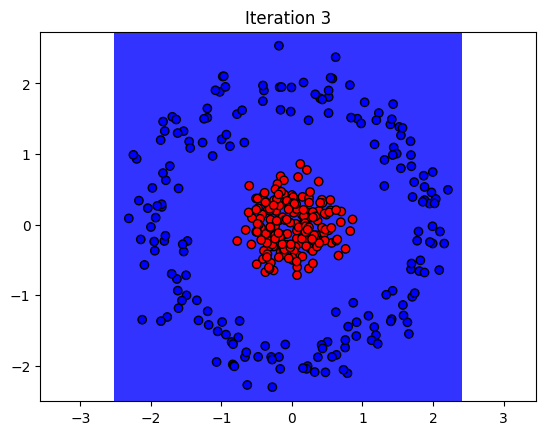

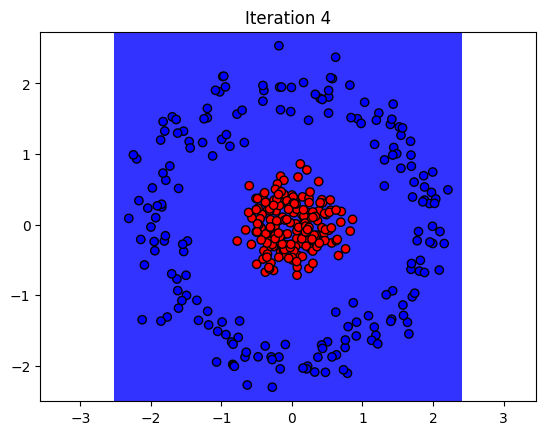

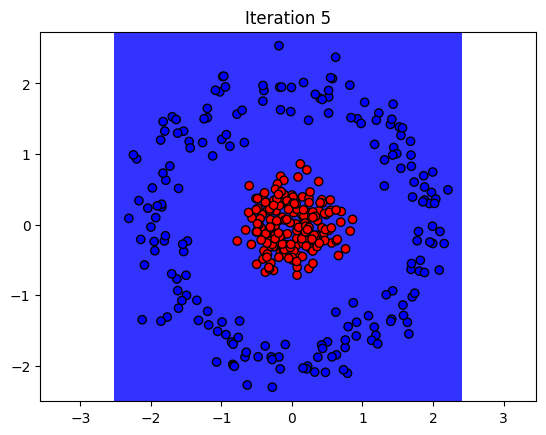

...

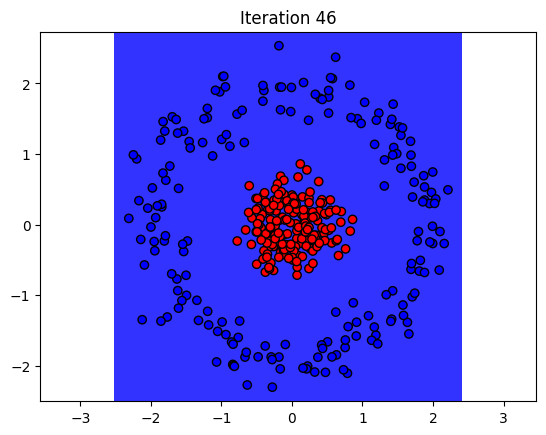

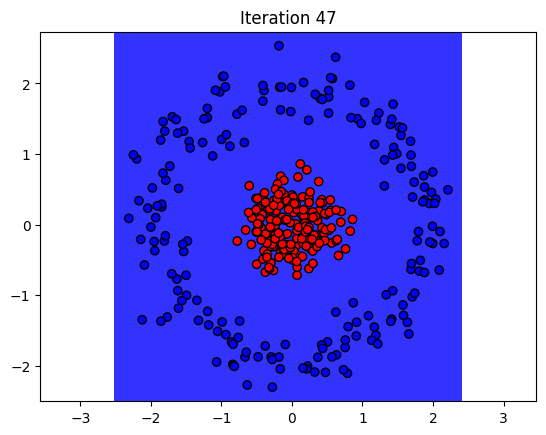

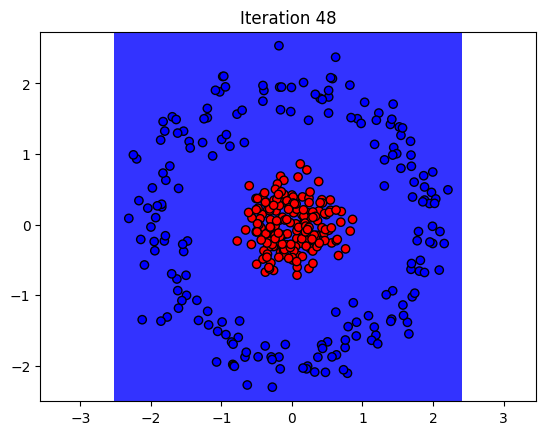

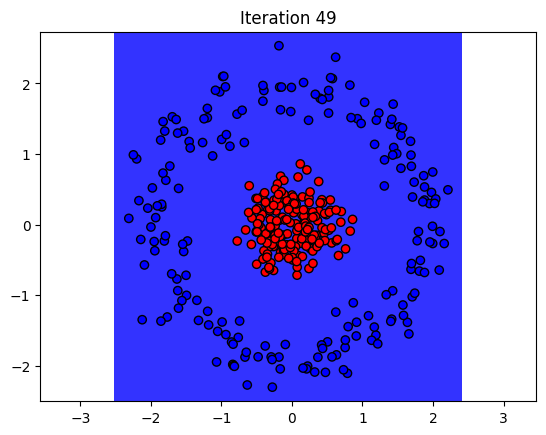

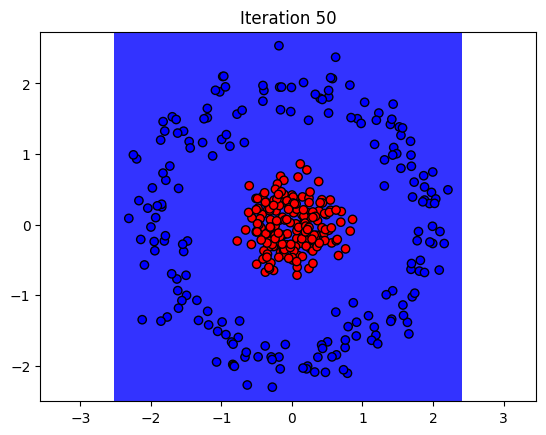

Accuracy with Linear SVM: 0.4880


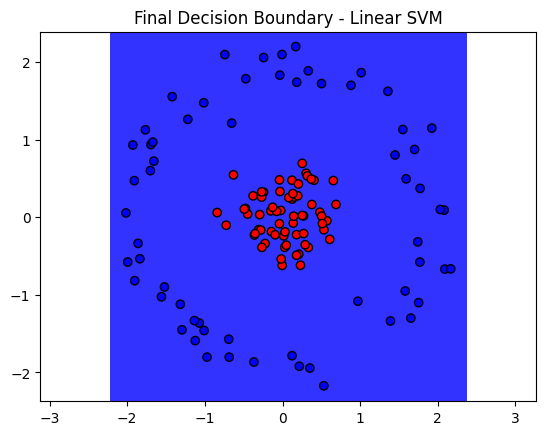

Running AdaBoost with LDA...


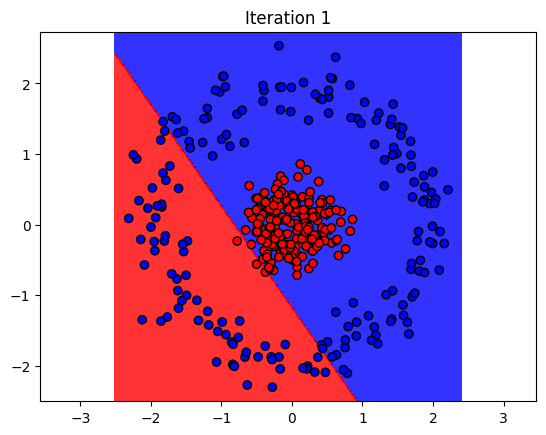

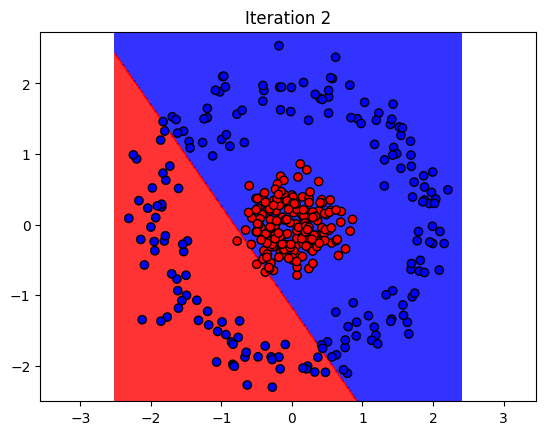

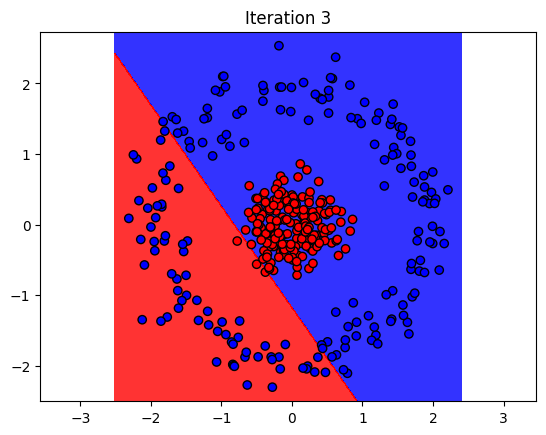

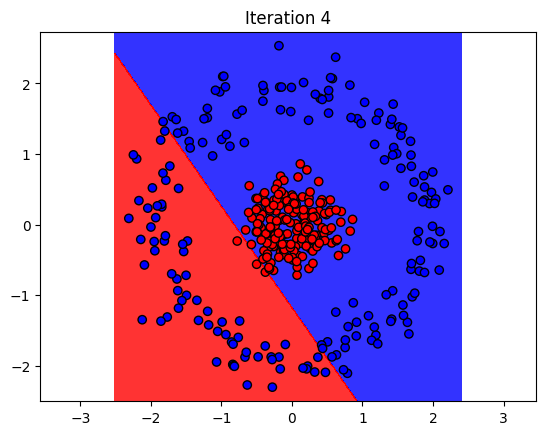

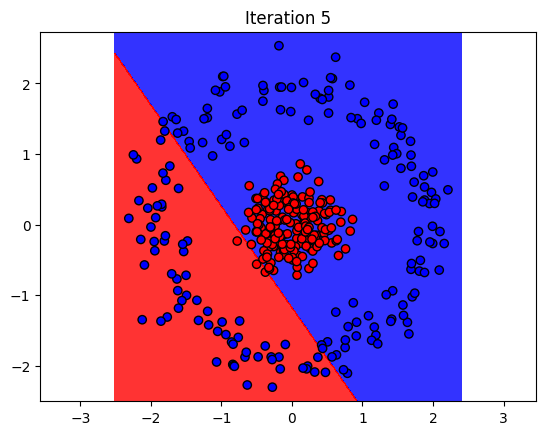

...

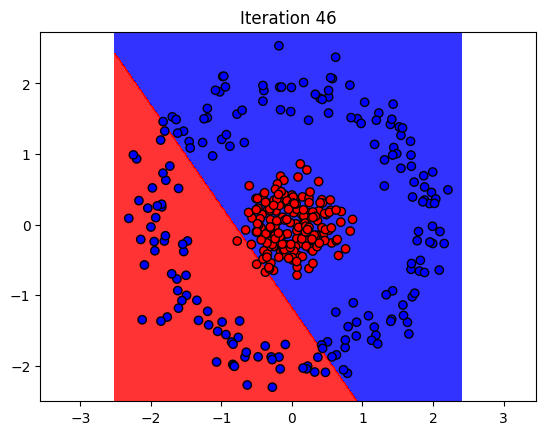

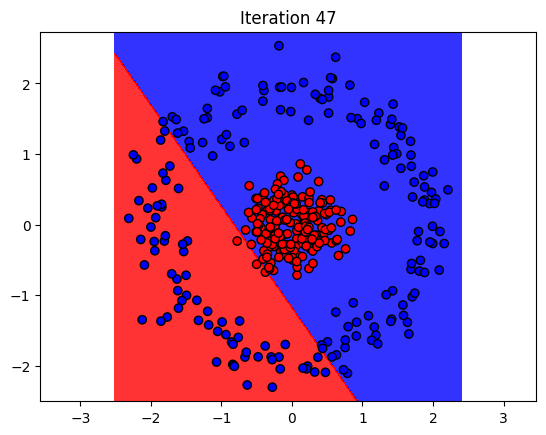

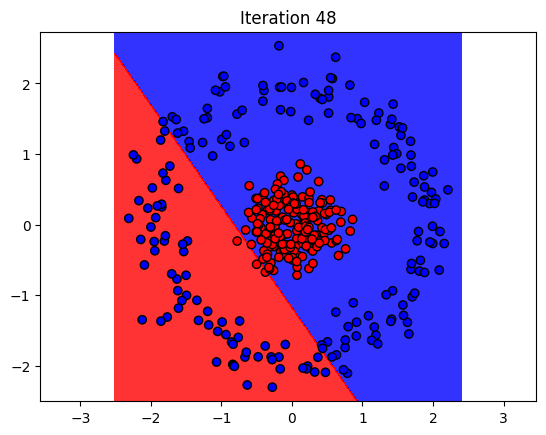

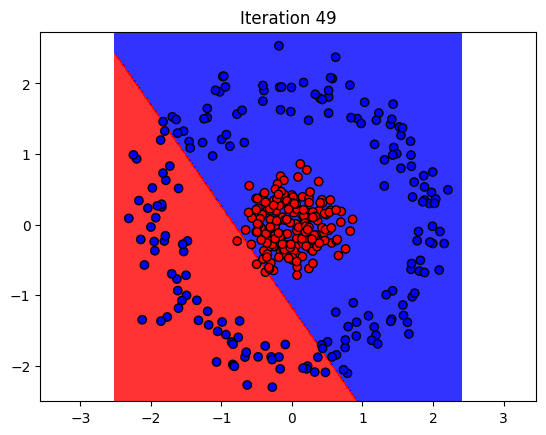

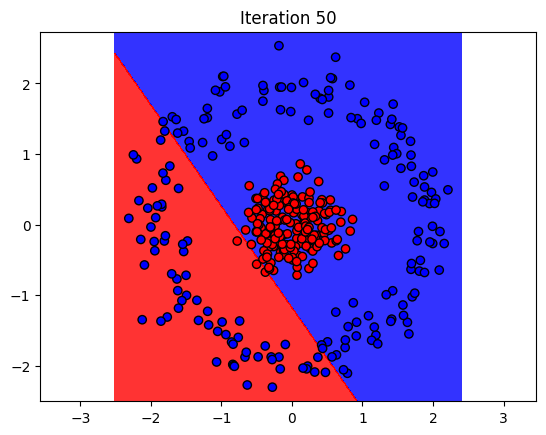

Accuracy with LDA: 0.7360


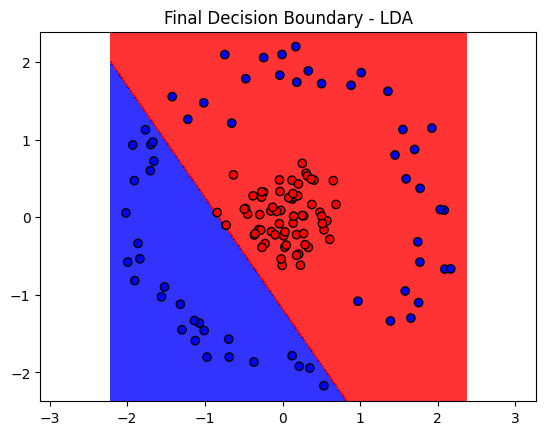


All Accuracies:
Logistic Regression: 0.7360
Decision Stump: 0.9920
Decision Tree (depth=3): 0.9920
Linear SVM: 0.4880
LDA: 0.7360


In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_circles
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score
from sklearn.utils.validation import has_fit_parameter
from sklearn.base import clone
import matplotlib.colors as colors

class AdaBoostCustom:
    def __init__(self, base_estimator, n_classifiers=50, eta=0.5):
        self.base_estimator = base_estimator
        self.n_classifiers = n_classifiers
        self.eta = eta
        self.classifiers = []
        self.alphas = []
    
    def fit(self, X, y):
        n_samples = X.shape[0]
        weights = np.ones(n_samples) / n_samples
        
        for i in range(self.n_classifiers):
            clf = clone(self.base_estimator)
            if has_fit_parameter(clf, 'sample_weight'):
                clf.fit(X, y, sample_weight=weights)
            else:
                clf.fit(X, y)
            
            predictions = clf.predict(X)
            err = np.sum(weights * (predictions != y)) / np.sum(weights)
            alpha = self.eta * np.log((1 - err) / err)
            
            weights *= np.exp(alpha * (predictions != y))
            weights /= np.sum(weights)
            
            self.classifiers.append(clf)
            self.alphas.append(alpha)
            self.plot_iteration(X, y, clf, i)
    
    def predict(self, X):
        final_pred = np.zeros(X.shape[0])
        for alpha, clf in zip(self.alphas, self.classifiers):
            final_pred += alpha * clf.predict(X)
        return np.sign(final_pred)
    
    def plot_iteration(self, X, y, clf, iteration):
        x_min, x_max = X[:, 0].min() - 0.2, X[:, 0].max() + 0.2
        y_min, y_max = X[:, 1].min() - 0.2, X[:, 1].max() + 0.2
        xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01),
                             np.arange(y_min, y_max, 0.01))
        Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
        Z = Z.reshape(xx.shape)

        plt.contourf(xx, yy, Z, alpha=0.8, cmap=colors.ListedColormap(["blue", "red"]))
        plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', cmap=colors.ListedColormap(["blue", "red"]))
        plt.title(f"Iteration {iteration + 1}")
        plt.axis('equal')
        plt.show()

def run_adaboost_with_classifiers():
    X, y = make_circles(n_samples=500, noise=0.1, random_state=42, factor=0.2)
    y = np.where(y == 0, -1, 1)  # Convert labels to {-1, 1}
    
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)
    
    param_grids = {
        "Logistic Regression": {"C": [0.01, 0.1, 1, 10]},
        "Linear SVM": {"C": [0.01, 0.1, 1, 10]},
        "LDA": {}
    }
    
    classifiers = {
        "Logistic Regression": LogisticRegression(solver='liblinear'),
        "Decision Stump": DecisionTreeClassifier(max_depth=1),
        "Decision Tree (depth=3)": DecisionTreeClassifier(max_depth=3),
        "Linear SVM": SVC(kernel="linear"),
        "LDA": LinearDiscriminantAnalysis()
    }

    accuracies = []  # To store accuracy results
    
    for clf_name, clf in classifiers.items():
        print(f"Running AdaBoost with {clf_name}...")
        
        if clf_name in param_grids and param_grids[clf_name]:
            grid = GridSearchCV(clf, param_grids[clf_name], cv=3)
            grid.fit(X_train, y_train)
            clf = grid.best_estimator_
        
        ada = AdaBoostCustom(base_estimator=clf, n_classifiers=50, eta=0.5)
        ada.fit(X_train, y_train)
        
        y_pred = ada.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        accuracies.append((clf_name, accuracy))
        print(f"Accuracy with {clf_name}: {accuracy:.4f}")
        
        plot_final_decision_boundary(ada, X_test, y_test, clf_name)

    # Print all accuracies together for comparison
    print("\nAll Accuracies:")
    for clf_name, accuracy in accuracies:
        print(f"{clf_name}: {accuracy:.4f}")

def plot_final_decision_boundary(clf, X, y, title):
    x_min, x_max = X[:, 0].min() - 0.2, X[:, 0].max() + 0.2
    y_min, y_max = X[:, 1].min() - 0.2, X[:, 1].max() + 0.2
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01),
                         np.arange(y_min, y_max, 0.01))
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(xx, yy, Z, alpha=0.8, cmap=colors.ListedColormap(["blue", "red"]))
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k', cmap=colors.ListedColormap(["blue", "red"]))
    plt.title(f"Final Decision Boundary - {title}")
    plt.axis('equal')
    plt.show()

run_adaboost_with_classifiers()
